#CODER HOUSE

**Data Science parte 2**

*Patricio Emmanuel Dueñas*

*Pre-Entrega*

##Introduccion

-La idea en principio es armar un mecanismo por el cual en el futbol se pueda predecir cual, o cuales jugadores son los mejores reemplazantes en una posicion determinada a la hora de hacer incorporaciones en un determinado plantel.
-El data set sera formado usando la libreria de Python "LanusStasts" que recopila datos estadisticos de varios sitios web dedicados al Futbol.
-El data frame final se logra al unir la informacion de varias ligas para la temporada 2023. El criterio para la seleccion de las mismas responde a la capacidad adquisitiva del club sujeto del analisis.
-El club sujeto del analisis es Boca Jrs y del mismo se simula la busqueda de un refuerzo para su platilla en una posicion determinada, a saber: volante central.


#Hipotesis

La hipotesis es que al menos un algoritmo de aprendisaje no supervisado es capaz de encontrar el mejor refuerzo para una posicion especifica haciendo uso de informacion de temporadas pasadas.

#Diccionario



1.  fBref: Futbol reference, la pagina desde donde se scrapea la informacion.
2.  misc_TklW: Tackles ganados.
3.  misc_Fld: Faltas ganadas.
4.  defense_Int: Intecepciones defensivas.
5.  misc_Crs: Cambios de fente.
6.  shooting_Sh: Disparos totales.
7.  stats_90s: Tiempo jugado por 90 minutos.






# Importado de librerias.

Pimero se importan las librerias y luego se buscan las ligas que van a formar el data frame.


In [179]:
pip install --upgrade LanusStats

In [180]:
import pandas as pd
import numpy as np
import seaborn as sns
import LanusStats as ls
import matplotlib.pyplot as plt

In [181]:
pd.set_option ('display.max_rows', None)

## Formacion del Data Frame

El data frame final estara compuesto por la informacion las ligas de Argentina, Chile, Colombia, Peru y Uruguay para la temporada 2023.

In [182]:
ls.get_available_leagues('Fbref')

['Copa de la Liga',
 'Primera Division Argentina',
 'Primera Division Uruguay',
 'Brasileirao',
 'Brasileirao B',
 'Primera Division Colombia',
 'Primera Division Chile',
 'Primera Division Peru',
 'Primera Division Venezuela',
 'Primera Division Ecuador',
 'Primera Division Bolivia',
 'Primera Division Paraguay',
 'Brasileirao F',
 'MLS',
 'USL Championship',
 'Premier League',
 'La Liga',
 'Ligue 1',
 'Bundesliga',
 'Serie A',
 'Big 5 European Leagues',
 'Danish Superliga',
 'Eredivise',
 'Primeira Liga Portugal',
 'Copa America',
 'Euros',
 'Saudi League',
 'EFL Championship',
 'La Liga 2',
 'Belgian Pro League',
 'Challenger Pro League',
 '2. Bundesliga',
 'Ligue 2',
 'Serie B',
 'J1 League',
 'NSWL',
 'Wowens Super League',
 'Liga F',
 'Premier Division South Africa',
 'Champions League',
 'Europa League',
 'Conference League',
 'Copa Libertadores',
 'Liga MX']

In [183]:
fbref = ls.Fbref()
ls.get_available_season_for_leagues ('Fbref', 'Primera Division Argentina')

{'id': 21,
 'slug': 'Primera-Division',
 'seasons': {'2021', '2022', '2023', '2024'}}

In [184]:
df= fbref.get_all_player_season_stats ('Primera Division Argentina','2023')

stats
Starting to scrape player data from Fbref...
keepers
Starting to scrape player data from Fbref...
keepersadv
Starting to scrape player data from Fbref...
shooting
Starting to scrape player data from Fbref...
passing
Starting to scrape player data from Fbref...
passing_types
Starting to scrape player data from Fbref...
gca
Starting to scrape player data from Fbref...
defense
Starting to scrape player data from Fbref...
possession
Starting to scrape player data from Fbref...
playingtime
Starting to scrape player data from Fbref...
misc
Starting to scrape player data from Fbref...


In [185]:
df_players = df[0]

In [186]:
df_players.head(8)

,Player,stats_Nation,stats_Pos,stats_Squad,stats_Comp,stats_Age,stats_Born,stats_MP,stats_Starts,stats_Min,...,misc_2CrdY,misc_Fls,misc_Fld,misc_Off,misc_Crs,misc_Int,misc_TklW,misc_PKwon,misc_PKcon,misc_OG
0,Ramón Ábila,ar ARG,FW,Colón,Primera Division Argentina,33,1989,25,17,"1,571",...,0,7,22,25,3,5,2,0.0,0.0,0
1,Gonzalo Abrego,ar ARG,MF,Godoy Cruz,Primera Division Argentina,23,2000,26,26,"2,134",...,0,20,8,3,20,21,29,0.0,0.0,0
2,Jonás Acevedo,ar ARG,"MF,FW",Huracán,Primera Division Argentina,25,1997,16,10,849,...,0,14,15,1,82,5,8,0.0,0.0,0
3,Lucas Acevedo,ar ARG,DF,Colón,Primera Division Argentina,31,1991,6,2,189,...,0,1,1,0,0,0,3,0.0,0.0,0
4,Guillermo Acosta,ar ARG,MF,Atlé Tucumán,Primera Division Argentina,34,1988,25,23,"1,874",...,0,25,25,0,11,25,26,0.0,0.0,0
5,Lautaro Acosta,ar ARG,MF,Lanús,Primera Division Argentina,34,1988,19,12,932,...,0,23,46,1,10,8,11,0.0,0.0,0
6,Lucas Acosta,ar ARG,GK,Lanús,Primera Division Argentina,27,1995,18,18,"1,620",...,0,1,0,0,0,1,0,0.0,0.0,0
7,Tomás Adoryán,ar ARG,MF,Banfield,Primera Division Argentina,21,2001,2,0,39,...,0,0,3,0,2,0,0,0.0,0.0,0


In [187]:
df_players.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 825 entries, 0 to 824
Columns: 206 entries, Player to misc_OG
dtypes: float64(86), object(120)
memory usage: 1.3+ MB


In [188]:
print(df_players.dtypes)

Player                   object
stats_Nation             object
stats_Pos                object
stats_Squad              object
stats_Comp               object
stats_Age                object
stats_Born               object
stats_MP                 object
stats_Starts             object
stats_Min                object
stats_90s                object
stats_Gls                object
stats_Ast                object
stats_G+A                object
stats_G-PK               object
stats_PK                 object
stats_PKatt              object
stats_CrdY               object
stats_CrdR               object
stats_Gls                object
stats_Ast                object
stats_G+A                object
stats_G-PK               object
stats_G+A-PK             object
shooting_Nation          object
shooting_Pos             object
shooting_Squad           object
shooting_Comp            object
shooting_Age             object
shooting_Born            object
shooting_90s             object
shooting

In [189]:
df_players.shape

(825, 206)

In [190]:
df_players.describe()

,shooting_Dist,passing_Cmp,passing_Att,passing_Cmp%,passing_TotDist,passing_PrgDist,passing_Cmp,passing_Att,passing_Cmp%,passing_Cmp,...,possession_Carries,possession_TotDist,possession_PrgDist,possession_1/3,possession_CPA,possession_Mis,possession_Dis,possession_Rec,misc_PKwon,misc_PKcon
count,825.0,825.0,825.0,825.0,825.0,825.0,825.0,825.0,825.0,825.0,...,825.0,825.0,825.0,825.0,825.0,825.0,825.0,825.0,825.0,825.0
mean,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
std,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
min,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
25%,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
50%,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
75%,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
max,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


In [191]:
df_players.isna().sum()

,0
Player,0
stats_Nation,0
stats_Pos,0
stats_Squad,0
stats_Comp,0
stats_Age,0
stats_Born,0
stats_MP,0
stats_Starts,0
stats_Min,0


In [192]:
fbref = ls.Fbref()
ls.get_available_season_for_leagues ('Fbref', 'Primera Division Chile')

{'id': 35,
 'slug': 'Primera-Division',
 'seasons': {'2021', '2022', '2023', '2024'}}

In [193]:
df1= fbref.get_all_player_season_stats ('Primera Division Chile','2023')

stats
Starting to scrape player data from Fbref...
keepers
Starting to scrape player data from Fbref...
keepersadv
Starting to scrape player data from Fbref...
shooting
Starting to scrape player data from Fbref...
passing
Starting to scrape player data from Fbref...
passing_types
Starting to scrape player data from Fbref...
gca
Starting to scrape player data from Fbref...
defense
Starting to scrape player data from Fbref...
possession
Starting to scrape player data from Fbref...
playingtime
Starting to scrape player data from Fbref...
misc
Starting to scrape player data from Fbref...


In [194]:
df_players1= df1[0]

In [195]:
df_players1.head(8)

,Player,stats_Nation,stats_Pos,stats_Squad,stats_Comp,stats_Age,stats_Born,stats_MP,stats_Starts,stats_Min,...,misc_2CrdY,misc_Fls,misc_Fld,misc_Off,misc_Crs,misc_Int,misc_TklW,misc_PKwon,misc_PKcon,misc_OG
0,Lucas Abascia,ar ARG,DF,Ñublense,Primera Division Chile,27,1995,17,12,"1,150",...,0,11,6,0,0,30,23,0.0,0.0,0
1,Joe Abrigo,cl CHI,MF,Coquimbo Unido,Primera Division Chile,27,1995,7,1,195,...,0,3,8,0,7,1,1,0.0,0.0,0
2,Joe Abrigo,cl CHI,MF,Palestino,Primera Division Chile,27,1995,14,11,839,...,0,3,8,0,7,1,1,0.0,0.0,0
3,Albert Acevedo,cl CHI,DF,Deportes Magallanes,Primera Division Chile,39,1983,10,6,555,...,0,7,4,0,0,9,10,0.0,0.0,0
4,Diego Acevedo,cl CHI,MF,Unión Española,Primera Division Chile,21,2001,10,2,204,...,0,3,0,0,10,1,5,0.0,0.0,0
5,Dilan Acevedo,cl CHI,MF,Curico Unido,Primera Division Chile,19,2003,3,1,123,...,0,0,2,1,1,1,0,0.0,0.0,0
6,Nelson Acevedo,ar ARG,MF,La Calera,Primera Division Chile,34,1988,8,7,541,...,0,8,6,0,0,14,10,0.0,0.0,0
7,Mateo Acosta,ar ARG,FW,Huachipato,Primera Division Chile,30,1992,10,4,341,...,0,6,2,2,1,2,7,0.0,0.0,0


In [196]:
df_players1.shape

(448, 206)

In [197]:
df_players1.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 448 entries, 0 to 447
Columns: 206 entries, Player to misc_OG
dtypes: float64(86), object(120)
memory usage: 721.1+ KB


In [198]:
print(df_players1.dtypes)

Player                   object
stats_Nation             object
stats_Pos                object
stats_Squad              object
stats_Comp               object
stats_Age                object
stats_Born               object
stats_MP                 object
stats_Starts             object
stats_Min                object
stats_90s                object
stats_Gls                object
stats_Ast                object
stats_G+A                object
stats_G-PK               object
stats_PK                 object
stats_PKatt              object
stats_CrdY               object
stats_CrdR               object
stats_Gls                object
stats_Ast                object
stats_G+A                object
stats_G-PK               object
stats_G+A-PK             object
shooting_Nation          object
shooting_Pos             object
shooting_Squad           object
shooting_Comp            object
shooting_Age             object
shooting_Born            object
shooting_90s             object
shooting

In [199]:
df_players1.describe()

,shooting_Dist,passing_Cmp,passing_Att,passing_Cmp%,passing_TotDist,passing_PrgDist,passing_Cmp,passing_Att,passing_Cmp%,passing_Cmp,...,possession_Carries,possession_TotDist,possession_PrgDist,possession_1/3,possession_CPA,possession_Mis,possession_Dis,possession_Rec,misc_PKwon,misc_PKcon
count,448.0,448.0,448.0,448.0,448.0,448.0,448.0,448.0,448.0,448.0,...,448.0,448.0,448.0,448.0,448.0,448.0,448.0,448.0,448.0,448.0
mean,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
std,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
min,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
25%,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
50%,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
75%,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
max,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


In [200]:
df_players1.isna().sum()

,0
Player,0
stats_Nation,0
stats_Pos,0
stats_Squad,0
stats_Comp,0
stats_Age,0
stats_Born,0
stats_MP,0
stats_Starts,0
stats_Min,0


In [201]:
ls.get_available_season_for_leagues('Fbref','Primera Division Colombia')

{'id': 41, 'slug': 'Primera-A', 'seasons': {'2021', '2022', '2023', '2024'}}

In [202]:
df2= fbref.get_all_player_season_stats ('Primera Division Colombia','2023')

stats
Starting to scrape player data from Fbref...
keepers
Starting to scrape player data from Fbref...
keepersadv
Starting to scrape player data from Fbref...
shooting
Starting to scrape player data from Fbref...
passing
Starting to scrape player data from Fbref...
passing_types
Starting to scrape player data from Fbref...
gca
Starting to scrape player data from Fbref...
defense
Starting to scrape player data from Fbref...
possession
Starting to scrape player data from Fbref...
playingtime
Starting to scrape player data from Fbref...
misc
Starting to scrape player data from Fbref...


In [203]:
df_players2= df2[0]

In [204]:
df_players2.describe()

,shooting_Dist,passing_Cmp,passing_Att,passing_Cmp%,passing_TotDist,passing_PrgDist,passing_Cmp,passing_Att,passing_Cmp%,passing_Cmp,...,possession_Carries,possession_TotDist,possession_PrgDist,possession_1/3,possession_CPA,possession_Mis,possession_Dis,possession_Rec,misc_PKwon,misc_PKcon
count,812.0,812.0,812.0,812.0,812.0,812.0,812.0,812.0,812.0,812.0,...,812.0,812.0,812.0,812.0,812.0,812.0,812.0,812.0,812.0,812.0
mean,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
std,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
min,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
25%,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
50%,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
75%,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
max,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


In [205]:
df_players2.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 812 entries, 0 to 811
Columns: 206 entries, Player to misc_OG
dtypes: float64(86), object(120)
memory usage: 1.3+ MB


In [206]:
print(df_players2.dtypes)

Player                   object
stats_Nation             object
stats_Pos                object
stats_Squad              object
stats_Comp               object
stats_Age                object
stats_Born               object
stats_MP                 object
stats_Starts             object
stats_Min                object
stats_90s                object
stats_Gls                object
stats_Ast                object
stats_G+A                object
stats_G-PK               object
stats_PK                 object
stats_PKatt              object
stats_CrdY               object
stats_CrdR               object
stats_Gls                object
stats_Ast                object
stats_G+A                object
stats_G-PK               object
stats_G+A-PK             object
shooting_Nation          object
shooting_Pos             object
shooting_Squad           object
shooting_Comp            object
shooting_Age             object
shooting_Born            object
shooting_90s             object
shooting

In [207]:
df_players2.shape

(812, 206)

In [208]:
fbref = ls.Fbref()
ls.get_available_season_for_leagues ('Fbref', 'Primera Division Uruguay')

{'id': 45,
 'slug': 'Primera-Division',
 'seasons': {'2021', '2022', '2023', '2024'}}

In [209]:
df3= fbref.get_all_player_season_stats ('Primera Division Uruguay','2023')

stats
Starting to scrape player data from Fbref...
keepers
Starting to scrape player data from Fbref...
keepersadv
Starting to scrape player data from Fbref...
shooting
Starting to scrape player data from Fbref...
passing
Starting to scrape player data from Fbref...
passing_types
Starting to scrape player data from Fbref...
gca
Starting to scrape player data from Fbref...
defense
Starting to scrape player data from Fbref...
possession
Starting to scrape player data from Fbref...
playingtime
Starting to scrape player data from Fbref...
misc
Starting to scrape player data from Fbref...


In [210]:
df_players3= df3[0]

In [211]:
df_players3.shape

(574, 206)

In [212]:
df_players3.describe()

,shooting_Sh,shooting_SoT,shooting_SoT%,shooting_Sh/90,shooting_SoT/90,shooting_G/Sh,shooting_G/SoT,shooting_Dist,passing_Cmp,passing_Att,...,possession_Dis,possession_Rec,misc_Fls,misc_Fld,misc_Off,misc_Crs,misc_Int,misc_TklW,misc_PKwon,misc_PKcon
count,574.0,574.0,574.0,574.0,574.0,574.0,574.0,574.0,574.0,574.0,...,574.0,574.0,574.0,574.0,574.0,574.0,574.0,574.0,574.0,574.0
mean,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
std,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
min,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
25%,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
50%,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
75%,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
max,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


In [213]:
df_players3.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 574 entries, 0 to 573
Columns: 206 entries, Player to misc_OG
dtypes: float64(102), object(104)
memory usage: 923.9+ KB


In [214]:
print(df_players3.dtypes)

Player                   object
stats_Nation             object
stats_Pos                object
stats_Squad              object
stats_Comp               object
stats_Age                object
stats_Born               object
stats_MP                 object
stats_Starts             object
stats_Min                object
stats_90s                object
stats_Gls                object
stats_Ast                object
stats_G+A                object
stats_G-PK               object
stats_PK                 object
stats_PKatt              object
stats_CrdY               object
stats_CrdR               object
stats_Gls                object
stats_Ast                object
stats_G+A                object
stats_G-PK               object
stats_G+A-PK             object
shooting_Nation          object
shooting_Pos             object
shooting_Squad           object
shooting_Comp            object
shooting_Age             object
shooting_Born            object
shooting_90s             object
shooting

In [215]:
fbref = ls.Fbref()
ls.get_available_season_for_leagues ('Fbref', 'Primera Division Peru')

{'id': 44, 'slug': 'Liga-1', 'seasons': {'2021', '2022', '2023', '2024'}}

In [216]:
df4= fbref.get_all_player_season_stats ('Primera Division Peru','2023')

stats
Starting to scrape player data from Fbref...
keepers
Starting to scrape player data from Fbref...
keepersadv
Starting to scrape player data from Fbref...
shooting
Starting to scrape player data from Fbref...
passing
Starting to scrape player data from Fbref...
passing_types
Starting to scrape player data from Fbref...
gca
Starting to scrape player data from Fbref...
defense
Starting to scrape player data from Fbref...
possession
Starting to scrape player data from Fbref...
playingtime
Starting to scrape player data from Fbref...
misc
Starting to scrape player data from Fbref...


In [217]:
df_players4= df4[0]

In [218]:
df_players4.describe()

,shooting_Sh,shooting_SoT,shooting_SoT%,shooting_Sh/90,shooting_SoT/90,shooting_G/Sh,shooting_G/SoT,shooting_Dist,passing_Cmp,passing_Att,...,possession_Rec,playingtime_On-Off,misc_Fls,misc_Fld,misc_Off,misc_Crs,misc_Int,misc_TklW,misc_PKwon,misc_PKcon
count,567.0,567.0,567.0,567.0,567.0,567.0,567.0,567.0,567.0,567.0,...,567.0,567.0,567.0,567.0,567.0,567.0,567.0,567.0,567.0,567.0
mean,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
std,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
min,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
25%,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
50%,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
75%,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
max,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


In [219]:
df_players4.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 567 entries, 0 to 566
Columns: 206 entries, Player to misc_OG
dtypes: float64(103), object(103)
memory usage: 912.6+ KB


In [220]:
print(df_players4.dtypes)

Player                   object
stats_Nation             object
stats_Pos                object
stats_Squad              object
stats_Comp               object
stats_Age                object
stats_Born               object
stats_MP                 object
stats_Starts             object
stats_Min                object
stats_90s                object
stats_Gls                object
stats_Ast                object
stats_G+A                object
stats_G-PK               object
stats_PK                 object
stats_PKatt              object
stats_CrdY               object
stats_CrdR               object
stats_Gls                object
stats_Ast                object
stats_G+A                object
stats_G-PK               object
stats_G+A-PK             object
shooting_Nation          object
shooting_Pos             object
shooting_Squad           object
shooting_Comp            object
shooting_Age             object
shooting_Born            object
shooting_90s             object
shooting

In [221]:
df_players4.shape

(567, 206)

##Comienzo a unir los diferentes data frame.
Primero junto todas las ligas que tenian el mismo numero de columnas para luego agregar a la liga Argentina que tiene algunas columnas mas que las otras ligas.


In [222]:
dfx = pd.concat([df_players1, df_players2,df_players3,df_players4], ignore_index=True)
dfx

,Player,stats_Nation,stats_Pos,stats_Squad,stats_Comp,stats_Age,stats_Born,stats_MP,stats_Starts,stats_Min,...,misc_2CrdY,misc_Fls,misc_Fld,misc_Off,misc_Crs,misc_Int,misc_TklW,misc_PKwon,misc_PKcon,misc_OG
0,Lucas Abascia,ar ARG,DF,Ñublense,Primera Division Chile,27,1995,17,12,"1,150",...,0,11,6,0,0,30,23,0.0,0.0,0
1,Joe Abrigo,cl CHI,MF,Coquimbo Unido,Primera Division Chile,27,1995,7,1,195,...,0,3,8,0,7,1,1,0.0,0.0,0
2,Joe Abrigo,cl CHI,MF,Palestino,Primera Division Chile,27,1995,14,11,839,...,0,3,8,0,7,1,1,0.0,0.0,0
3,Albert Acevedo,cl CHI,DF,Deportes Magallanes,Primera Division Chile,39,1983,10,6,555,...,0,7,4,0,0,9,10,0.0,0.0,0
4,Diego Acevedo,cl CHI,MF,Unión Española,Primera Division Chile,21,2001,10,2,204,...,0,3,0,0,10,1,5,0.0,0.0,0
5,Dilan Acevedo,cl CHI,MF,Curico Unido,Primera Division Chile,19,2003,3,1,123,...,0,0,2,1,1,1,0,0.0,0.0,0
6,Nelson Acevedo,ar ARG,MF,La Calera,Primera Division Chile,34,1988,8,7,541,...,0,8,6,0,0,14,10,0.0,0.0,0
7,Mateo Acosta,ar ARG,FW,Huachipato,Primera Division Chile,30,1992,10,4,341,...,0,6,2,2,1,2,7,0.0,0.0,0
8,Nicolás Aedo,cl CHI,DF,La Calera,Primera Division Chile,21,2001,8,0,109,...,0,2,0,0,6,0,2,0.0,0.0,0
9,Tomás Ahumada,cl CHI,GK,Audax Italiano,Primera Division Chile,21,2001,25,25,"2,250",...,0,0,4,0,0,1,1,0.0,0.0,0


In [223]:
list(dfx.columns)

['Player',
 'stats_Nation',
 'stats_Pos',
 'stats_Squad',
 'stats_Comp',
 'stats_Age',
 'stats_Born',
 'stats_MP',
 'stats_Starts',
 'stats_Min',
 'stats_90s',
 'stats_Gls',
 'stats_Ast',
 'stats_G+A',
 'stats_G-PK',
 'stats_PK',
 'stats_PKatt',
 'stats_CrdY',
 'stats_CrdR',
 'stats_Gls',
 'stats_Ast',
 'stats_G+A',
 'stats_G-PK',
 'stats_G+A-PK',
 'shooting_Nation',
 'shooting_Pos',
 'shooting_Squad',
 'shooting_Comp',
 'shooting_Age',
 'shooting_Born',
 'shooting_90s',
 'shooting_Gls',
 'shooting_Sh',
 'shooting_SoT',
 'shooting_SoT%',
 'shooting_Sh/90',
 'shooting_SoT/90',
 'shooting_G/Sh',
 'shooting_G/SoT',
 'shooting_Dist',
 'shooting_PK',
 'shooting_PKatt',
 'passing_Nation',
 'passing_Pos',
 'passing_Squad',
 'passing_Comp',
 'passing_Age',
 'passing_Born',
 'passing_90s',
 'passing_Cmp',
 'passing_Att',
 'passing_Cmp%',
 'passing_TotDist',
 'passing_PrgDist',
 'passing_Cmp',
 'passing_Att',
 'passing_Cmp%',
 'passing_Cmp',
 'passing_Att',
 'passing_Cmp%',
 'passing_Cmp',
 'pas

## Igualo el numero de columnas para poder concatenarlas.


In [224]:
common_columns = dfx.columns.intersection(df_players.columns)

common_columns

Index(['Player', 'stats_Nation', 'stats_Pos', 'stats_Squad', 'stats_Comp',
       'stats_Age', 'stats_Born', 'stats_MP', 'stats_Starts', 'stats_Min',
       ...
       'misc_2CrdY', 'misc_Fls', 'misc_Fld', 'misc_Off', 'misc_Crs',
       'misc_Int', 'misc_TklW', 'misc_PKwon', 'misc_PKcon', 'misc_OG'],
      dtype='object', length=186)

In [225]:
pd.Series(common_columns)

,0
0,Player
1,stats_Nation
2,stats_Pos
3,stats_Squad
4,stats_Comp
5,stats_Age
6,stats_Born
7,stats_MP
8,stats_Starts
9,stats_Min


In [226]:
duplicates = common_columns[common_columns.duplicated()]

if duplicates.empty:
    print("No hay nombres repetidos.")
else:
    print("Nombres repetidos:", duplicates.tolist())

No hay nombres repetidos.


In [227]:
df_players_filtered = df_players[common_columns]                                                         # Filtro los DataFrames con respecto a las columnas en comun.

dfx_filtered = dfx[common_columns]

In [228]:
df_players_filtered.shape

(825, 206)

In [229]:
dfx_filtered.shape

(2401, 206)

In [230]:
pd.Series(df_players_filtered.columns)

,0
0,Player
1,stats_Nation
2,stats_Pos
3,stats_Squad
4,stats_Comp
5,stats_Age
6,stats_Born
7,stats_MP
8,stats_Starts
9,stats_Min


In [231]:
pd.Series(dfx_filtered.columns)

,0
0,Player
1,stats_Nation
2,stats_Pos
3,stats_Squad
4,stats_Comp
5,stats_Age
6,stats_Born
7,stats_MP
8,stats_Starts
9,stats_Min


In [232]:
df_players_filtered.shape

(825, 206)

In [233]:
dfx_filtered.shape

(2401, 206)

In [234]:
df_F = pd.concat([df_players_filtered, dfx_filtered], ignore_index=True)                         # Con ambos dataframe con las mismas dimensiones paso cocatenarlos para obtener el dataframe final con todas las ligas.

In [236]:
df_F                                                                                            # En el dataframe final descubro que algunos jugadores figuran mas de una vez debido a que pasaron de un club a otro en la misma temporada.
                                                                                                # Luego descubro que algunas columnas tambien estan repetidas.

,Player,stats_Nation,stats_Pos,stats_Squad,stats_Comp,stats_Age,stats_Born,stats_MP,stats_Starts,stats_Min,...,misc_2CrdY,misc_Fls,misc_Fld,misc_Off,misc_Crs,misc_Int,misc_TklW,misc_PKwon,misc_PKcon,misc_OG
0,Ramón Ábila,ar ARG,FW,Colón,Primera Division Argentina,33,1989,25,17,"1,571",...,0,7,22,25,3,5,2,0.0,0.0,0
1,Gonzalo Abrego,ar ARG,MF,Godoy Cruz,Primera Division Argentina,23,2000,26,26,"2,134",...,0,20,8,3,20,21,29,0.0,0.0,0
2,Jonás Acevedo,ar ARG,"MF,FW",Huracán,Primera Division Argentina,25,1997,16,10,849,...,0,14,15,1,82,5,8,0.0,0.0,0
3,Lucas Acevedo,ar ARG,DF,Colón,Primera Division Argentina,31,1991,6,2,189,...,0,1,1,0,0,0,3,0.0,0.0,0
4,Guillermo Acosta,ar ARG,MF,Atlé Tucumán,Primera Division Argentina,34,1988,25,23,"1,874",...,0,25,25,0,11,25,26,0.0,0.0,0
5,Lautaro Acosta,ar ARG,MF,Lanús,Primera Division Argentina,34,1988,19,12,932,...,0,23,46,1,10,8,11,0.0,0.0,0
6,Lucas Acosta,ar ARG,GK,Lanús,Primera Division Argentina,27,1995,18,18,"1,620",...,0,1,0,0,0,1,0,0.0,0.0,0
7,Tomás Adoryán,ar ARG,MF,Banfield,Primera Division Argentina,21,2001,2,0,39,...,0,0,3,0,2,0,0,0.0,0.0,0
8,Luis Advíncula,pe PER,"DF,FW",Boca Juniors,Primera Division Argentina,32,1990,18,16,"1,438",...,0,20,18,2,38,7,23,0.0,0.0,0
9,Facundo Aguero,ar ARG,DF,Rosario Central,Primera Division Argentina,28,1995,5,1,126,...,0,4,1,0,1,3,1,0.0,0.0,0


In [237]:
df_F.shape

(3226, 206)

## Jugadores duplicados y columnas repetidas
A continuacion trato con estas cuestiones para dejar el data frame parejo.
Durante el preceso descubro que para las columnas repetidas me faltaban datos en alguna de las ligas siendo su eliminacion la unica solucion asi como otros casos donde la repeticion respondia mas al scrapeado de la pagina web, donde tambien la eliminacion resulta la mejor opcion.

In [238]:
Jug_duplicados = df_F[df_F.duplicated(subset='Player', keep=False)]                         # Identifico y ordeno los jugadores que figuran mas de una vez.

Jug_duplicados

,Player,stats_Nation,stats_Pos,stats_Squad,stats_Comp,stats_Age,stats_Born,stats_MP,stats_Starts,stats_Min,...,misc_2CrdY,misc_Fls,misc_Fld,misc_Off,misc_Crs,misc_Int,misc_TklW,misc_PKwon,misc_PKcon,misc_OG
93,Brian Blando,ar ARG,FW,Lanús,Primera Division Argentina,27,1995,4,0,64,...,0,2,0,0,3,0,2,0.0,0.0,0
127,Juan Cáceres,py PAR,DF,Lanús,Primera Division Argentina,22,2000,20,20,"1,800",...,0,27,15,0,57,33,51,0.0,0.0,0
128,Juan Cáceres,py PAR,DF,Racing Club,Primera Division Argentina,22,2000,1,1,35,...,0,27,15,0,57,33,51,0.0,0.0,0
137,Jhonatan Candia,uy URU,FW,Rosario Central,Primera Division Argentina,27,1995,11,7,559,...,0,8,5,2,5,3,4,0.0,0.0,0
144,Edwin Cardona,co COL,FW,Racing Club,Primera Division Argentina,30,1992,5,1,90,...,0,3,0,0,5,0,1,0.0,0.0,0
150,Lucas Carrizo,ar ARG,DF,Huracán,Primera Division Argentina,25,1997,9,6,576,...,0,7,3,0,18,7,16,0.0,0.0,0
186,Leandro Contín,ar ARG,FW,Gimnasia–LP,Primera Division Argentina,27,1995,6,3,214,...,0,2,1,1,0,0,3,0.0,0.0,0
196,Ayrton Cougo,uy URU,"DF,FW",Sarmiento,Primera Division Argentina,26,1996,6,0,68,...,0,5,0,0,0,1,1,0.0,0.0,0
201,Juan Cuesta,co COL,"MF,FW",Arsenal,Primera Division Argentina,20,2002,8,3,346,...,0,5,9,2,15,3,3,0.0,0.0,0
222,Leandro Díaz,ar ARG,FW,Lanús,Primera Division Argentina,30,1992,24,23,"2,052",...,1,31,25,19,21,6,8,0.0,0.0,0


In [239]:
duplicados_ordenados = Jug_duplicados.sort_values(by='Player')

print(duplicados_ordenados)

                           Player stats_Nation stats_Pos          stats_Squad  \
2139                Adrián Balboa       uy URU        FW             Defensor   
1355                Adrián Balboa       uy URU        FW              Pereira   
1543               Adrián Estacio       co COL     MF,FW             Rionegro   
1544               Adrián Estacio       co COL     MF,FW                Pasto   
1183            Agustín Rodríguez       uy URU        FW            La Calera   
2543            Agustín Rodríguez       uy URU        MF               Racing   
658                Alan Rodríguez       uy URU        MF          Arg Juniors   
657                Alan Rodríguez       py PAR     DF,MF      Rosario Central   
2687              Alberto Ampuero       pe PER        DF           Binacional   
2686              Alberto Ampuero       pe PER     DF,MF        Dep Municipal   
1424              Aldair Cantillo       co COL        DF       CA Bucaramanga   
1423              Aldair Can

In [240]:
fila = df_F.iloc[694]                                                                      #Exploro algunos casos.
print(fila)

Player                              Carlos Sánchez
stats_Nation                                co COL
stats_Pos                                    MF,DF
stats_Squad                            San Lorenzo
stats_Comp              Primera Division Argentina
stats_Age                                       36
stats_Born                                    1986
stats_MP                                        23
stats_Starts                                    19
stats_Min                                    1,491
stats_90s                                     16.6
stats_Gls                                        0
stats_Gls                                     0.00
stats_Ast                                        0
stats_Ast                                     0.00
stats_G+A                                        0
stats_G+A                                     0.00
stats_G-PK                                       0
stats_G-PK                                    0.00
stats_PK                       

In [241]:
fila = df_F.iloc[2573]
print(fila)

Player                            Carlos Sánchez
stats_Nation                              uy URU
stats_Pos                                     MF
stats_Squad                              Peñarol
stats_Comp              Primera Division Uruguay
stats_Age                                     38
stats_Born                                  1984
stats_MP                                      20
stats_Starts                                   9
stats_Min                                    698
stats_90s                                    7.8
stats_Gls                                      3
stats_Gls                                   0.39
stats_Ast                                      0
stats_Ast                                   0.00
stats_G+A                                      3
stats_G+A                                   0.39
stats_G-PK                                     2
stats_G-PK                                  0.26
stats_PK                                       1
stats_PKatt         

In [242]:
fila = df_F.iloc[1777]
print(fila)

Player                              Daniel Moreno
stats_Nation                               co COL
stats_Pos                                   MF,FW
stats_Squad                                 Pasto
stats_Comp              Primera Division Colombia
stats_Age                                      28
stats_Born                                   1995
stats_MP                                       44
stats_Starts                                   34
stats_Min                                   2,846
stats_90s                                    31.6
stats_Gls                                       2
stats_Gls                                    0.06
stats_Ast                                       5
stats_Ast                                    0.16
stats_G+A                                       7
stats_G+A                                    0.22
stats_G-PK                                      1
stats_G-PK                                   0.03
stats_PK                                        1


In [243]:
fila = df_F.iloc[1778]
print(fila)

Player                               Dayro Moreno
stats_Nation                               co COL
stats_Pos                                      FW
stats_Squad                           Once Caldas
stats_Comp              Primera Division Colombia
stats_Age                                      37
stats_Born                                   1985
stats_MP                                       40
stats_Starts                                   39
stats_Min                                   3,409
stats_90s                                    37.9
stats_Gls                                      20
stats_Gls                                    0.53
stats_Ast                                       3
stats_Ast                                    0.08
stats_G+A                                      23
stats_G+A                                    0.61
stats_G-PK                                     14
stats_G-PK                                   0.37
stats_PK                                        6


In [244]:
fila = df_F.iloc[3116]
print(fila)

Player                           Diego Romero
stats_Nation                           pe PER
stats_Pos                                  GK
stats_Squad                     Universitario
stats_Comp              Primera Division Peru
stats_Age                                  21
stats_Born                               2001
stats_MP                                    8
stats_Starts                                8
stats_Min                                 720
stats_90s                                 8.0
stats_Gls                                   0
stats_Gls                                0.00
stats_Ast                                   0
stats_Ast                                0.00
stats_G+A                                   0
stats_G+A                                0.00
stats_G-PK                                  0
stats_G-PK                               0.00
stats_PK                                    0
stats_PKatt                                 0
stats_CrdY                        

In [245]:
fila = df_F.iloc[2562]
print(fila)

Player                              Diego Romero
stats_Nation                              uy URU
stats_Pos                                     MF
stats_Squad                            Maldonado
stats_Comp              Primera Division Uruguay
stats_Age                                     22
stats_Born                                  2000
stats_MP                                      24
stats_Starts                                  16
stats_Min                                  1,551
stats_90s                                   17.2
stats_Gls                                      0
stats_Gls                                   0.00
stats_Ast                                      0
stats_Ast                                   0.00
stats_G+A                                      0
stats_G+A                                   0.00
stats_G-PK                                     0
stats_G-PK                                  0.00
stats_PK                                       0
stats_PKatt         

In [246]:
nombres_repetidos = df_F['Player'].duplicated(keep=False).sum()                         # Constato que al menos un jugador tuvo mas de dos equipos, por no ser el numero de repetidos par.

print(f'Número de nombres repetidos: {nombres_repetidos}')

Número de nombres repetidos: 409


In [247]:
jugadores_duplicados = Jug_duplicados['Player'].unique()                                 # Obtener nombres únicos.

In [248]:
df_F = df_F[~df_F['Player'].isin(jugadores_duplicados)]                                  # Filtro el Data Frame para eliminar los jugadores duplicados.


In [249]:
df_F.shape

(2817, 206)

In [250]:
list(df_F.columns)

['Player',
 'stats_Nation',
 'stats_Pos',
 'stats_Squad',
 'stats_Comp',
 'stats_Age',
 'stats_Born',
 'stats_MP',
 'stats_Starts',
 'stats_Min',
 'stats_90s',
 'stats_Gls',
 'stats_Gls',
 'stats_Ast',
 'stats_Ast',
 'stats_G+A',
 'stats_G+A',
 'stats_G-PK',
 'stats_G-PK',
 'stats_PK',
 'stats_PKatt',
 'stats_CrdY',
 'stats_CrdR',
 'stats_G+A-PK',
 'shooting_Nation',
 'shooting_Pos',
 'shooting_Squad',
 'shooting_Comp',
 'shooting_Age',
 'shooting_Born',
 'shooting_90s',
 'shooting_Gls',
 'shooting_Sh',
 'shooting_SoT',
 'shooting_SoT%',
 'shooting_Sh/90',
 'shooting_SoT/90',
 'shooting_G/Sh',
 'shooting_G/SoT',
 'shooting_Dist',
 'shooting_PK',
 'shooting_PKatt',
 'passing_Nation',
 'passing_Pos',
 'passing_Squad',
 'passing_Comp',
 'passing_Age',
 'passing_Born',
 'passing_90s',
 'passing_Cmp',
 'passing_Cmp',
 'passing_Cmp',
 'passing_Cmp',
 'passing_Att',
 'passing_Att',
 'passing_Att',
 'passing_Att',
 'passing_Cmp%',
 'passing_Cmp%',
 'passing_Cmp%',
 'passing_Cmp%',
 'passing_To

In [251]:
repetidos = df_F.columns.value_counts()                                                # Cuento las repeticiones de nombres de columnas.


repetidos = repetidos[repetidos > 1]                                                   # Filtro solo los nombres de columnas que se repiten.

print(repetidos)

passing_Cmp%    4
passing_Att     4
passing_Cmp     4
stats_G-PK      2
stats_Ast       2
stats_Gls       2
stats_G+A       2
gca_TO          2
gca_PassDead    2
gca_PassLive    2
gca_Sh          2
gca_Fld         2
gca_Def         2
defense_Tkl     2
Name: count, dtype: int64


In [252]:
resultados = []

for column_name in repetidos.index:

    indices = [i for i, col in enumerate(df_F.columns) if col == column_name]
    resultados.append((column_name, repetidos[column_name], indices))


In [253]:
for columna, repeticiones, indices in resultados:
    print(f'Columna: {columna}, Repeticiones: {repeticiones}, Índices: {indices}')

Columna: passing_Cmp%, Repeticiones: 4, Índices: [57, 58, 59, 60]
Columna: passing_Att, Repeticiones: 4, Índices: [53, 54, 55, 56]
Columna: passing_Cmp, Repeticiones: 4, Índices: [49, 50, 51, 52]
Columna: stats_G-PK, Repeticiones: 2, Índices: [17, 18]
Columna: stats_Ast, Repeticiones: 2, Índices: [13, 14]
Columna: stats_Gls, Repeticiones: 2, Índices: [11, 12]
Columna: stats_G+A, Repeticiones: 2, Índices: [15, 16]
Columna: gca_TO, Repeticiones: 2, Índices: [104, 105]
Columna: gca_PassDead, Repeticiones: 2, Índices: [102, 103]
Columna: gca_PassLive, Repeticiones: 2, Índices: [100, 101]
Columna: gca_Sh, Repeticiones: 2, Índices: [106, 107]
Columna: gca_Fld, Repeticiones: 2, Índices: [108, 109]
Columna: gca_Def, Repeticiones: 2, Índices: [110, 111]
Columna: defense_Tkl, Repeticiones: 2, Índices: [121, 122]


In [254]:
df_F['passing_Cmp']                                                                   #Exploro los casos.

,passing_Cmp,passing_Cmp,passing_Cmp,passing_Cmp
0,0.0,0.0,0.0,0.0
1,0.0,0.0,0.0,0.0
2,0.0,0.0,0.0,0.0
3,0.0,0.0,0.0,0.0
4,0.0,0.0,0.0,0.0
5,0.0,0.0,0.0,0.0
6,0.0,0.0,0.0,0.0
7,0.0,0.0,0.0,0.0
8,0.0,0.0,0.0,0.0
9,0.0,0.0,0.0,0.0


In [255]:
df_F['passing_Att']

,passing_Att,passing_Att,passing_Att,passing_Att
0,0.0,0.0,0.0,0.0
1,0.0,0.0,0.0,0.0
2,0.0,0.0,0.0,0.0
3,0.0,0.0,0.0,0.0
4,0.0,0.0,0.0,0.0
5,0.0,0.0,0.0,0.0
6,0.0,0.0,0.0,0.0
7,0.0,0.0,0.0,0.0
8,0.0,0.0,0.0,0.0
9,0.0,0.0,0.0,0.0


In [256]:
df_F['passing_Cmp%']

,passing_Cmp%,passing_Cmp%,passing_Cmp%,passing_Cmp%
0,0.0,0.0,0.0,0.0
1,0.0,0.0,0.0,0.0
2,0.0,0.0,0.0,0.0
3,0.0,0.0,0.0,0.0
4,0.0,0.0,0.0,0.0
5,0.0,0.0,0.0,0.0
6,0.0,0.0,0.0,0.0
7,0.0,0.0,0.0,0.0
8,0.0,0.0,0.0,0.0
9,0.0,0.0,0.0,0.0


In [257]:
df_F['gca_Def']

,gca_Def,gca_Def
0,0.0,0.0
1,0.0,0.0
2,0.0,0.0
3,0.0,0.0
4,0.0,0.0
5,0.0,0.0
6,0.0,0.0
7,0.0,0.0
8,0.0,0.0
9,0.0,0.0


In [258]:
df_F['gca_PassLive']

,gca_PassLive,gca_PassLive
0,0.0,0.0
1,0.0,0.0
2,0.0,0.0
3,0.0,0.0
4,0.0,0.0
5,0.0,0.0
6,0.0,0.0
7,0.0,0.0
8,0.0,0.0
9,0.0,0.0


In [259]:
df_F['gca_PassDead']

,gca_PassDead,gca_PassDead
0,0.0,0.0
1,0.0,0.0
2,0.0,0.0
3,0.0,0.0
4,0.0,0.0
5,0.0,0.0
6,0.0,0.0
7,0.0,0.0
8,0.0,0.0
9,0.0,0.0


In [260]:
df_F['stats_G-PK']                                                                    #Tiene Valores.

,stats_G-PK,stats_G-PK
0,6,0.34
1,3,0.13
2,0,0.00
3,0,0.00
4,0,0.00
5,0,0.00
6,0,0.00
7,0,0.00
8,0,0.00
9,0,0.00


In [261]:
df_F['stats_G+A']                                                                      #Tiene Valores.

,stats_G+A,stats_G+A
0,9,0.52
1,4,0.17
2,1,0.11
3,0,0.00
4,2,0.10
5,0,0.00
6,0,0.00
7,0,0.00
8,3,0.19
9,0,0.00


In [262]:
df_F['stats_Ast']                                                                      #Tiene Valores.

,stats_Ast,stats_Ast
0,3,0.17
1,1,0.04
2,1,0.11
3,0,0.00
4,2,0.10
5,0,0.00
6,0,0.00
7,0,0.00
8,3,0.19
9,0,0.00


In [263]:
df_F['stats_Gls']                                                                      #Tiene Valores.

,stats_Gls,stats_Gls
0,6,0.34
1,3,0.13
2,0,0.00
3,0,0.00
4,0,0.00
5,0,0.00
6,0,0.00
7,0,0.00
8,0,0.00
9,0,0.00


In [264]:
df_F['gca_TO']

,gca_TO,gca_TO
0,0.0,0.0
1,0.0,0.0
2,0.0,0.0
3,0.0,0.0
4,0.0,0.0
5,0.0,0.0
6,0.0,0.0
7,0.0,0.0
8,0.0,0.0
9,0.0,0.0


In [265]:
df_F['gca_Fld']

,gca_Fld,gca_Fld
0,0.0,0.0
1,0.0,0.0
2,0.0,0.0
3,0.0,0.0
4,0.0,0.0
5,0.0,0.0
6,0.0,0.0
7,0.0,0.0
8,0.0,0.0
9,0.0,0.0


In [266]:
df_F['defense_Tkl']

,defense_Tkl,defense_Tkl
0,0.0,0.0
1,0.0,0.0
2,0.0,0.0
3,0.0,0.0
4,0.0,0.0
5,0.0,0.0
6,0.0,0.0
7,0.0,0.0
8,0.0,0.0
9,0.0,0.0


In [267]:
df_F['gca_Sh']

,gca_Sh,gca_Sh
0,0.0,0.0
1,0.0,0.0
2,0.0,0.0
3,0.0,0.0
4,0.0,0.0
5,0.0,0.0
6,0.0,0.0
7,0.0,0.0
8,0.0,0.0
9,0.0,0.0


###Renombro las columnas repetidas que tenian valores ya que respondia a la misma estadistica pero en relacion a un porcentaje de tiempo jugado.

In [268]:
df_F.columns.values[18] = 'stats_G-PK2'

In [269]:
df_F.columns.values[16] = 'stats_G+A2'

In [270]:
df_F.columns.values[14] = 'stats_Ast2'

In [271]:
df_F.columns.values[12] = 'stats_Gls2'

### Elimino las columnas repetidas que no tenian valores.

In [272]:
indices_a_eliminar = [49, 50, 51, 52, 53, 54, 55, 56, 57, 58, 59, 60, 100, 101, 102, 103, 104, 105, 106, 107, 108, 109, 110, 111, 121, 122]

In [273]:
df_F.drop(df_F.columns[indices_a_eliminar], axis=1, inplace=True)                      #Elimino las columnas repetidas

In [274]:
repetidos = df_F.columns.value_counts()


repetidos = repetidos[repetidos > 1]

print(repetidos)

Series([], Name: count, dtype: int64)


In [275]:
df_F.shape

(2817, 180)

In [276]:
df_F['Player'].dtype

dtype('O')

In [277]:
df_F.size

507060

In [278]:
df_F.count()

,0
Player,2817
stats_Nation,2817
stats_Pos,2817
stats_Squad,2817
stats_Comp,2817
stats_Age,2817
stats_Born,2817
stats_MP,2817
stats_Starts,2817
stats_Min,2817


In [279]:
df_F.info()

<class 'pandas.core.frame.DataFrame'>
Index: 2817 entries, 0 to 3225
Columns: 180 entries, Player to misc_OG
dtypes: float64(60), object(120)
memory usage: 3.9+ MB


In [280]:
df_F.describe()

,shooting_Dist,passing_TotDist,passing_PrgDist,passing_A-xAG,passing_KP,passing_1/3,passing_PPA,passing_CrsPA,passing_types_Att,passing_types_Live,...,possession_Carries,possession_TotDist,possession_PrgDist,possession_1/3,possession_CPA,possession_Mis,possession_Dis,possession_Rec,misc_PKwon,misc_PKcon
count,2817.0,2817.0,2817.0,2817.0,2817.0,2817.0,2817.0,2817.0,2817.0,2817.0,...,2817.0,2817.0,2817.0,2817.0,2817.0,2817.0,2817.0,2817.0,2817.0,2817.0
mean,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
std,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
min,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
25%,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
50%,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
75%,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
max,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


In [281]:
print(df_F.dtypes)

Player                   object
stats_Nation             object
stats_Pos                object
stats_Squad              object
stats_Comp               object
stats_Age                object
stats_Born               object
stats_MP                 object
stats_Starts             object
stats_Min                object
stats_90s                object
stats_Gls                object
stats_Gls2               object
stats_Ast                object
stats_Ast2               object
stats_G+A                object
stats_G+A2               object
stats_G-PK               object
stats_G-PK2              object
stats_PK                 object
stats_PKatt              object
stats_CrdY               object
stats_CrdR               object
stats_G+A-PK             object
shooting_Nation          object
shooting_Pos             object
shooting_Squad           object
shooting_Comp            object
shooting_Age             object
shooting_Born            object
shooting_90s             object
shooting

In [282]:
df_F

,Player,stats_Nation,stats_Pos,stats_Squad,stats_Comp,stats_Age,stats_Born,stats_MP,stats_Starts,stats_Min,...,misc_2CrdY,misc_Fls,misc_Fld,misc_Off,misc_Crs,misc_Int,misc_TklW,misc_PKwon,misc_PKcon,misc_OG
0,Ramón Ábila,ar ARG,FW,Colón,Primera Division Argentina,33,1989,25,17,"1,571",...,0,7,22,25,3,5,2,0.0,0.0,0
1,Gonzalo Abrego,ar ARG,MF,Godoy Cruz,Primera Division Argentina,23,2000,26,26,"2,134",...,0,20,8,3,20,21,29,0.0,0.0,0
2,Jonás Acevedo,ar ARG,"MF,FW",Huracán,Primera Division Argentina,25,1997,16,10,849,...,0,14,15,1,82,5,8,0.0,0.0,0
3,Lucas Acevedo,ar ARG,DF,Colón,Primera Division Argentina,31,1991,6,2,189,...,0,1,1,0,0,0,3,0.0,0.0,0
4,Guillermo Acosta,ar ARG,MF,Atlé Tucumán,Primera Division Argentina,34,1988,25,23,"1,874",...,0,25,25,0,11,25,26,0.0,0.0,0
5,Lautaro Acosta,ar ARG,MF,Lanús,Primera Division Argentina,34,1988,19,12,932,...,0,23,46,1,10,8,11,0.0,0.0,0
6,Lucas Acosta,ar ARG,GK,Lanús,Primera Division Argentina,27,1995,18,18,"1,620",...,0,1,0,0,0,1,0,0.0,0.0,0
7,Tomás Adoryán,ar ARG,MF,Banfield,Primera Division Argentina,21,2001,2,0,39,...,0,0,3,0,2,0,0,0.0,0.0,0
8,Luis Advíncula,pe PER,"DF,FW",Boca Juniors,Primera Division Argentina,32,1990,18,16,"1,438",...,0,20,18,2,38,7,23,0.0,0.0,0
9,Facundo Aguero,ar ARG,DF,Rosario Central,Primera Division Argentina,28,1995,5,1,126,...,0,4,1,0,1,3,1,0.0,0.0,0


##Tipos de dato

Hay que modificar el tipo de dato "Object" y pasarlo al que corresponde.

In [283]:
lista_columnas_con_indices = [(index, column) for index, column in enumerate(df_F.columns)]                    #Genero un indice de las columnas
lista_columnas_con_indices

[(0, 'Player'),
 (1, 'stats_Nation'),
 (2, 'stats_Pos'),
 (3, 'stats_Squad'),
 (4, 'stats_Comp'),
 (5, 'stats_Age'),
 (6, 'stats_Born'),
 (7, 'stats_MP'),
 (8, 'stats_Starts'),
 (9, 'stats_Min'),
 (10, 'stats_90s'),
 (11, 'stats_Gls'),
 (12, 'stats_Gls2'),
 (13, 'stats_Ast'),
 (14, 'stats_Ast2'),
 (15, 'stats_G+A'),
 (16, 'stats_G+A2'),
 (17, 'stats_G-PK'),
 (18, 'stats_G-PK2'),
 (19, 'stats_PK'),
 (20, 'stats_PKatt'),
 (21, 'stats_CrdY'),
 (22, 'stats_CrdR'),
 (23, 'stats_G+A-PK'),
 (24, 'shooting_Nation'),
 (25, 'shooting_Pos'),
 (26, 'shooting_Squad'),
 (27, 'shooting_Comp'),
 (28, 'shooting_Age'),
 (29, 'shooting_Born'),
 (30, 'shooting_90s'),
 (31, 'shooting_Gls'),
 (32, 'shooting_Sh'),
 (33, 'shooting_SoT'),
 (34, 'shooting_SoT%'),
 (35, 'shooting_Sh/90'),
 (36, 'shooting_SoT/90'),
 (37, 'shooting_G/Sh'),
 (38, 'shooting_G/SoT'),
 (39, 'shooting_Dist'),
 (40, 'shooting_PK'),
 (41, 'shooting_PKatt'),
 (42, 'passing_Nation'),
 (43, 'passing_Pos'),
 (44, 'passing_Squad'),
 (45, 'pas

In [284]:
columnas_NoC= ['Player','stats_Nation','stats_Pos','stats_Squad','stats_Comp','stats_Born','stats_MP']        #Columnas a convertir a tipo numéricas.
columnas_AC = df_F.columns.difference(columnas_NoC)


for col in columnas_AC:
    try:
        df_F[col] = pd.to_numeric(df_F[col], errors='coerce')
    except Exception as e:
        print(f"Error al convertir la columna '{col}': {e}")


df_F.dtypes

,0
Player,object
stats_Nation,object
stats_Pos,object
stats_Squad,object
stats_Comp,object
stats_Age,int64
stats_Born,object
stats_MP,object
stats_Starts,int64
stats_Min,float64


In [285]:
indices_to_string = [0,1,2,3,4,7]                                                                           #Columnas a convertir a tipo string.


df_F.iloc[:, indices_to_string] = df_F.iloc[:, indices_to_string].astype(str)

In [286]:
df_F.shape

(2817, 180)

In [321]:
df_F.isna().sum()                                                                                        # Aca tengo algunas dudas porque por el momento creia no tener valores "NaN" pero despues parece que si encuentro algunos.
                                                                                                         # Chequeo las columnas y me encuentro con que no son significativas para el proyecto asi que las borro.
                                                                                                         # De todas formas tengo que mirar mas en profundidad que paso.

,0
Player,0
stats_Nation,0
stats_Pos,0
stats_Squad,0
stats_Comp,0
stats_Age,0
stats_Born,0
stats_MP,0
stats_Starts,0
stats_90s,0


In [288]:
df_F.isnull().sum()

,0
Player,0
stats_Nation,0
stats_Pos,0
stats_Squad,0
stats_Comp,0
stats_Age,0
stats_Born,0
stats_MP,0
stats_Starts,0
stats_Min,1356


In [322]:
nan_columns = df_F.columns[df_F.isnull().any()]                                                 # Identificar columnas con valores NaN

print("Columnas con datos NaN:", nan_columns.tolist())

Columnas con datos NaN: []


In [290]:
df_F.dropna(axis=1, inplace=True)                                                              # Eliminar columnas con valores NaN


In [291]:
df_F.shape

(2817, 146)

## Soporte Grafico
La idea es graficar para explorar las varibles que considero mas relevantes.

In [340]:
df_Fseleccion = df_F[['misc_TklW', 'misc_Fld','defense_Int','misc_Crs','stats_90s','shooting_Sh']]

In [341]:
corr_matrix = df_Fseleccion.corr()

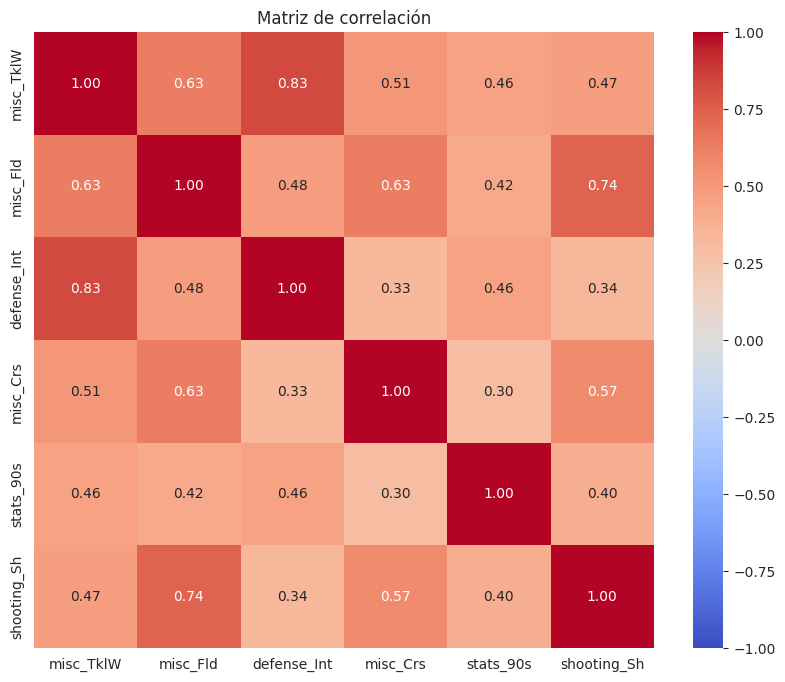

In [342]:
plt.figure(figsize=(10, 8))  # Ajustar el tamaño si es necesario
sns.heatmap(corr_matrix, annot=True, cmap='coolwarm', fmt='.2f', vmin=-1, vmax=1)

# Mostrar el gráfico
plt.title('Matriz de correlación')
plt.show()

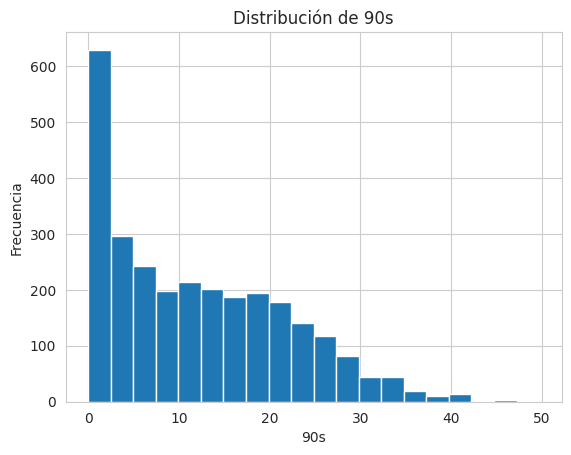

In [336]:
df_F['stats_90s'].hist(bins=20)
plt.title('Distribución de 90s')
plt.xlabel('90s')
plt.ylabel('Frecuencia')
plt.show()

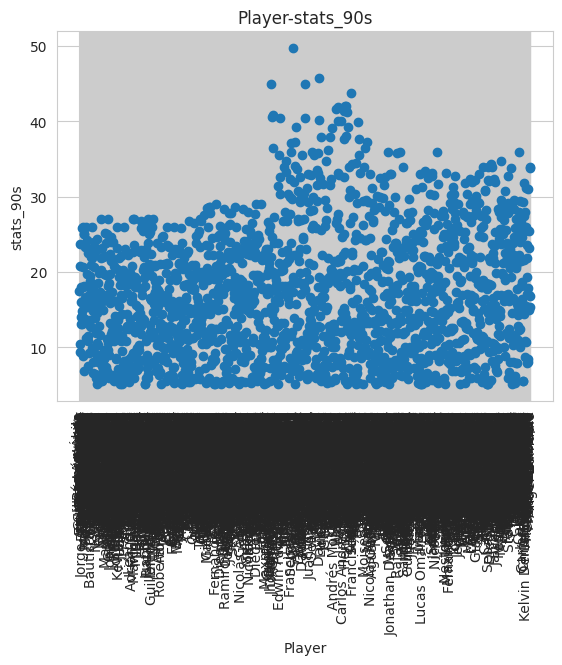

In [296]:
min_90s = 5                                                                                       #Aplico un filtro para sacar jugadores que participaron pocos minutos.
df_F90s = df_F[df_F['stats_90s'] > min_90s]


fig, ax = plt.subplots()
ax.scatter(data=df_F90s, x='Player', y='stats_90s')
ax.set_xlabel('Player')
ax.set_ylabel('stats_90s')
ax.set_title('Player-stats_90s')


plt.xticks(rotation=90)
plt.show()

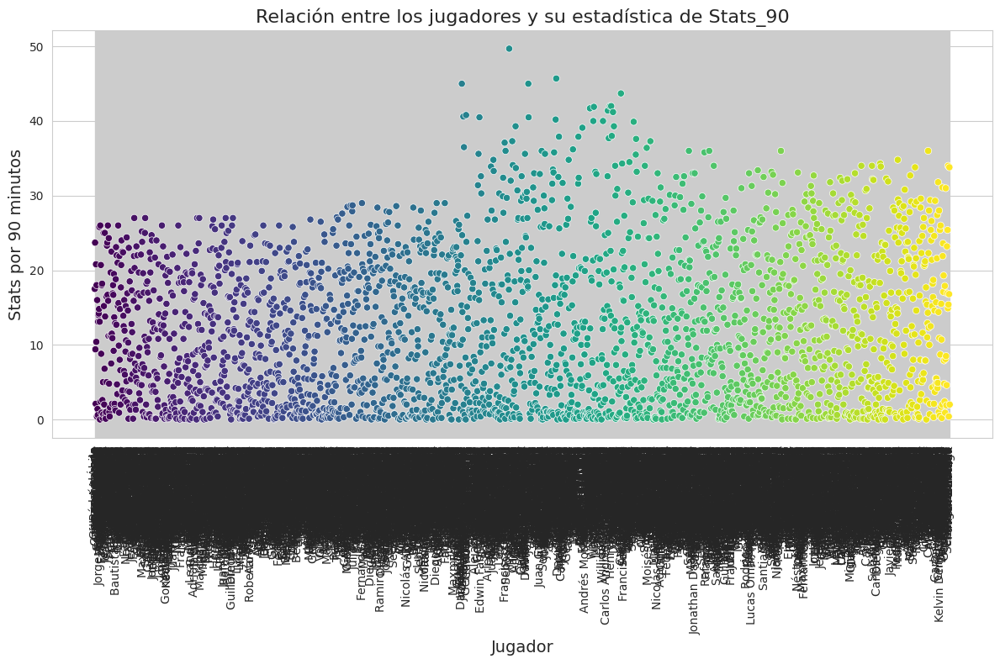

In [298]:
sns.set_style('whitegrid')

plt.figure(figsize=(12, 8))

sns.scatterplot(x='Player', y='stats_90s', data=df_F, hue='Player', palette='viridis', legend=None)

plt.title('Relación entre los jugadores y su estadística de Stats_90', fontsize=16)
plt.xlabel('Jugador', fontsize=14)
plt.ylabel('Stats por 90 minutos', fontsize=14)


plt.xticks(rotation=90)

plt.tight_layout()


plt.show()

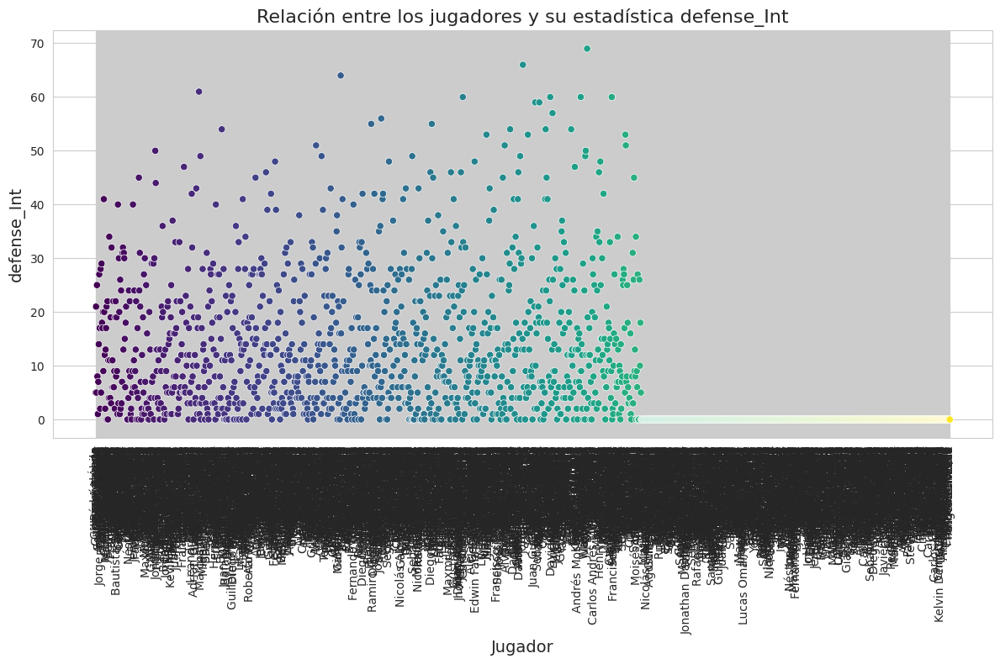

In [324]:

sns.set_style('whitegrid')

plt.figure(figsize=(12, 8))

sns.scatterplot(x='Player', y='defense_Int', data=df_F90s, hue='Player', palette='viridis', legend=None)

plt.title('Relación entre los jugadores y su estadística defense_Int', fontsize=16)
plt.xlabel('Jugador', fontsize=14)
plt.ylabel('defense_Int', fontsize=14)


plt.xticks(rotation=90)

plt.tight_layout()


plt.show()

Text(0, 0.5, 'defense_TklW')

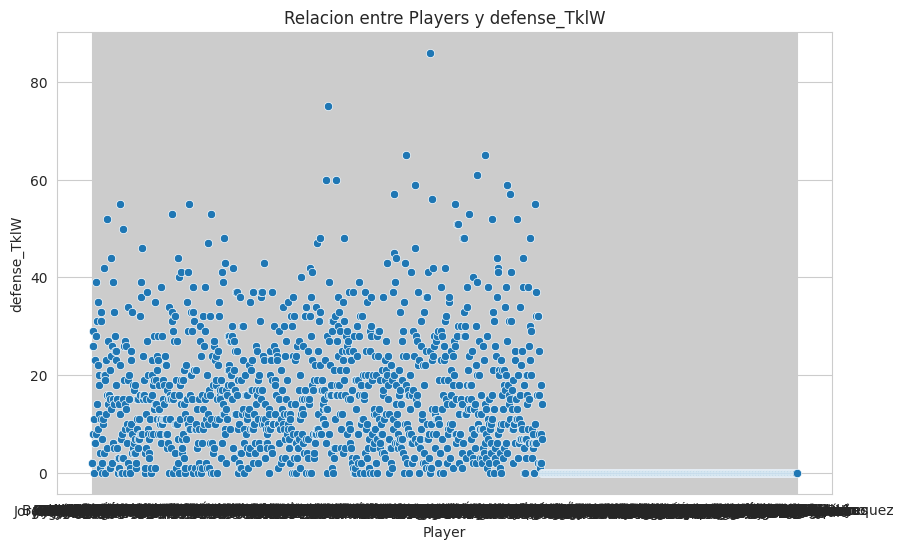

In [300]:
sns.set_style('whitegrid')
plt.figure(figsize=(10,6))
sns.scatterplot(x='Player', y='defense_TklW' ,data=df_F90s)
plt.title('Relacion entre Players y defense_TklW')
plt.xlabel('Player')
plt.ylabel('defense_TklW')

Text(0, 0.5, 'shooting_Sh')

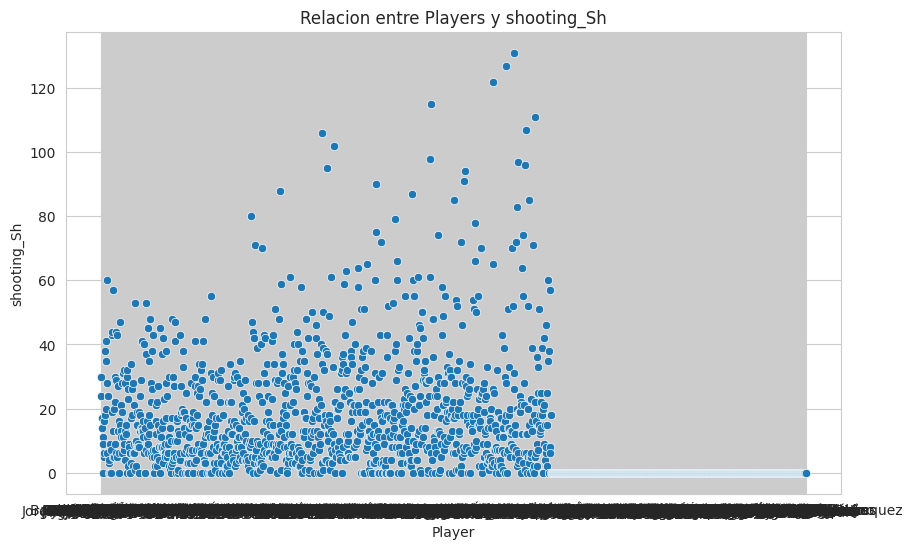

In [299]:
sns.set_style('whitegrid')
plt.figure(figsize=(10,6))
sns.scatterplot(x='Player', y='shooting_Sh' ,data=df_F90s)
plt.title('Relacion entre Players y shooting_Sh')
plt.xlabel('Player')
plt.ylabel('shooting_Sh')

<Axes: xlabel='defense_TklW', ylabel='Count'>

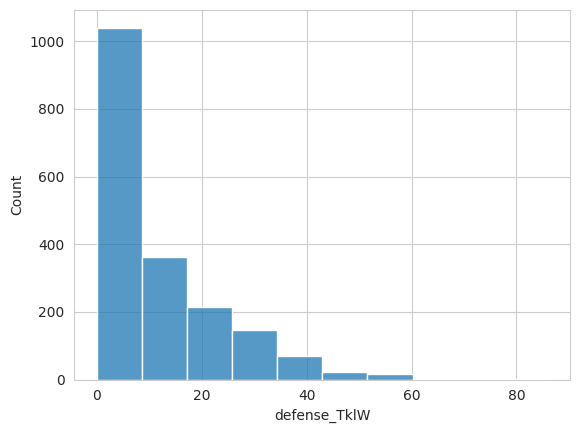

In [301]:
sns.histplot(data=df_F90s, x='defense_TklW',bins=10)

<Axes: xlabel='misc_Crs', ylabel='Count'>

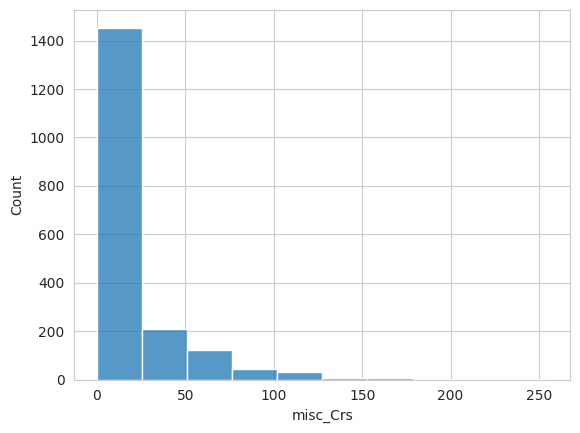

In [303]:
sns.histplot(data=df_F90s, x='misc_Crs',bins=10)

<Axes: xlabel='defense_Int', ylabel='Count'>

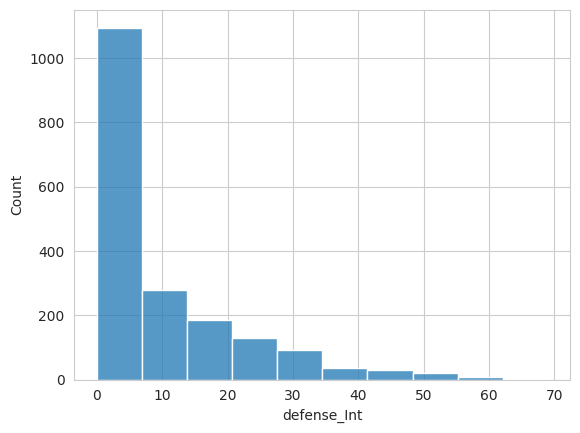

In [305]:
sns.histplot(data=df_F90s, x='defense_Int',bins=10)

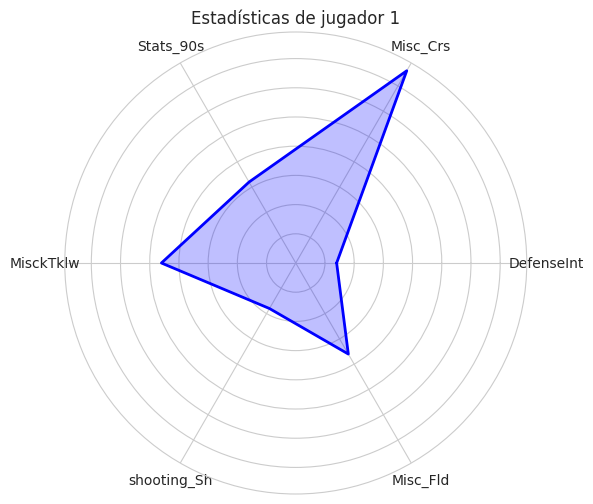

In [344]:
labels = ['DefenseInt', 'Misc_Crs', 'Stats_90s', 'MisckTklw','shooting_Sh','Misc_Fld']
values = df_F.iloc[8][['defense_Int', 'misc_Crs', 'stats_90s', 'misc_TklW','shooting_Sh','misc_Fld']].values
angles = np.linspace(0, 2 * np.pi, len(labels), endpoint=False).tolist()
values=np.concatenate((values,[values[0]]))
angles+=angles[:1]

fig, ax = plt.subplots(figsize=(6, 6), subplot_kw=dict(polar=True))
ax.fill(angles, values, color='blue', alpha=0.25)
ax.plot(angles, values, color='blue', linewidth=2)
ax.set_yticklabels([])
ax.set_xticks(angles[:-1])
ax.set_xticklabels(labels)
plt.title('Estadísticas de jugador 1')
plt.show()

##Outliers

Como era esperable se nota la presencia de outliers ya que en algunas estadisticas, como por ejemplo en cambios de frente o takles ganados, no son muchos los jugadores que destacan. Esto va de la mano con la distribucion sesgada a la derecha que presentan la mayoria de las variables seleccionadas, demostrando que la menor cantidad de jugadores se queda con las estadisticas mas altas. Tambien por otro ejemplo son los arqueros que suelen jugar la mayor cantidad de minutos y no son reemplazados casi nunca.
Como refuerzo para la exploracion se aplica un filtro para dejar afuera a jugadores que participaron de pocos minutos durante la temporada y asi de esta forma evitar sesgar los datos.